<a href="https://colab.research.google.com/github/ssahaxd/notebooks/blob/master/Toonify_yourself.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Toonify yourself!

Please ensure that you're using a GPU runtime

First some setup:

In [1]:
%tensorflow_version 1.x

TensorFlow 1.x selected.


In [2]:
!git clone https://github.com/justinpinkney/stylegan2
%cd stylegan2
!nvcc test_nvcc.cu -o test_nvcc -run

Cloning into 'stylegan2'...
remote: Enumerating objects: 269, done.
remote: Total 269 (delta 0), reused 0 (delta 0), pack-reused 269
Receiving objects: 100% (269/269), 2.31 MiB | 22.35 MiB/s, done.
Resolving deltas: 100% (143/143), done.
/content/stylegan2
CPU says hello.
GPU says hello.


In [3]:
!pwd
!mkdir raw
!mkdir aligned
!mkdir generated

/content/stylegan2


## Upload your own photos

Upload your photos to `raw/`. These don't need to be aligned as we'll use a face detector to grab all the faces and transform them into the correct format. One note of caution is that you'll need a pretty high-resolution picture of a face to get a sharp result (the final face crop is resized to 1024x1024 pixels)

We'll grab a example image from the internet to work with.

The basic process is:
- Extract faces and align the images
- Project the images (i.e. find the latent code)
- Toonify the images (i.e. use the latent code with the toon model)

Results will be placed in the stylegan2/generated folder

In [ ]:
# !wget https://upload.wikimedia.org/wikipedia/commons/6/6d/Shinz%C5%8D_Abe_Official.jpg -O raw/example.jpg

--2020-09-01 21:48:16--  https://upload.wikimedia.org/wikipedia/commons/6/6d/Shinz%C5%8D_Abe_Official.jpg
Resolving upload.wikimedia.org (upload.wikimedia.org)... 91.198.174.208, 2620:0:862:ed1a::2:b
Connecting to upload.wikimedia.org (upload.wikimedia.org)|91.198.174.208|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 332712 (325K) [image/jpeg]
Saving to: ‘raw/example.jpg’

raw/example.jpg     100%[===================>] 324.91K  --.-KB/s    in 0.02s   

2020-09-01 21:48:16 (16.3 MB/s) - ‘raw/example.jpg’ saved [332712/332712]



In [5]:
import pretrained_networks

# use my copy of the blended model to save Doron's download bandwidth
# get the original here https://mega.nz/folder/OtllzJwa#C947mCCdEfMCRTWnDcs4qw
blended_url = "https://drive.google.com/uc?id=1tGXnjVzwu-2OTbbyXv1S8XZfTRjmcIUG" 
ffhq_url = "http://d36zk2xti64re0.cloudfront.net/stylegan2/networks/stylegan2-ffhq-config-f.pkl"

_, _, Gs_blended = pretrained_networks.load_networks(blended_url)
_, _, Gs = pretrained_networks.load_networks(ffhq_url)

Setting up TensorFlow plugin "fused_bias_act.cu": Preprocessing... Compiling... Loading... Done.
Setting up TensorFlow plugin "upfirdn_2d.cu": Preprocessing... Compiling... Loading... Done.


In [47]:
!python align_images.py raw aligned

In [ ]:
from IPython.display import Image 

import glob

files = glob.glob("aligned/*.*")
print(files)

for i in files:
  display(Image(filename=i, width=256))


In [49]:
!python project_images.py --num-steps 500 aligned generated

Loading networks from "http://d36zk2xti64re0.cloudfront.net/stylegan2/networks/stylegan2-ffhq-config-f.pkl"...
Setting up TensorFlow plugin "fused_bias_act.cu": Preprocessing... Loading... Done.
Setting up TensorFlow plugin "upfirdn_2d.cu": Preprocessing... Loading... Done.
Loading images from ".stylegan2-tmp/dataset/images"
detected 1 images ...
Creating dataset ".stylegan2-tmp/dataset/tfrecords"
Adding the images to tfrecords ...
added images 0
Added 1 images.
Projecting image "Adrija_01.png"...
2020-09-25 08:56:51.874395: W tensorflow/core/lib/png/png_io.cc:88] PNG warning: iCCP: known incorrect sRGB profile
Loading images from ".stylegan2-tmp/dataset/images"
detected 1 images ...
Creating dataset ".stylegan2-tmp/dataset/tfrecords"
Adding the images to tfrecords ...
added images 0
Added 1 images.
Projecting image "sushi2_01.png"...
2020-09-25 08:58:32.708935: W tensorflow/core/lib/png/png_io.cc:88] PNG warning: iCCP: known incorrect sRGB profile
Loading images from ".stylegan2-tmp/d

['aligned/sushi_01.png', 'aligned/sushi4_01.png', 'aligned/sushi2_01.png', 'aligned/sushi3_01.png', 'aligned/sushi5_01.png', 'aligned/Adrija_01.png']


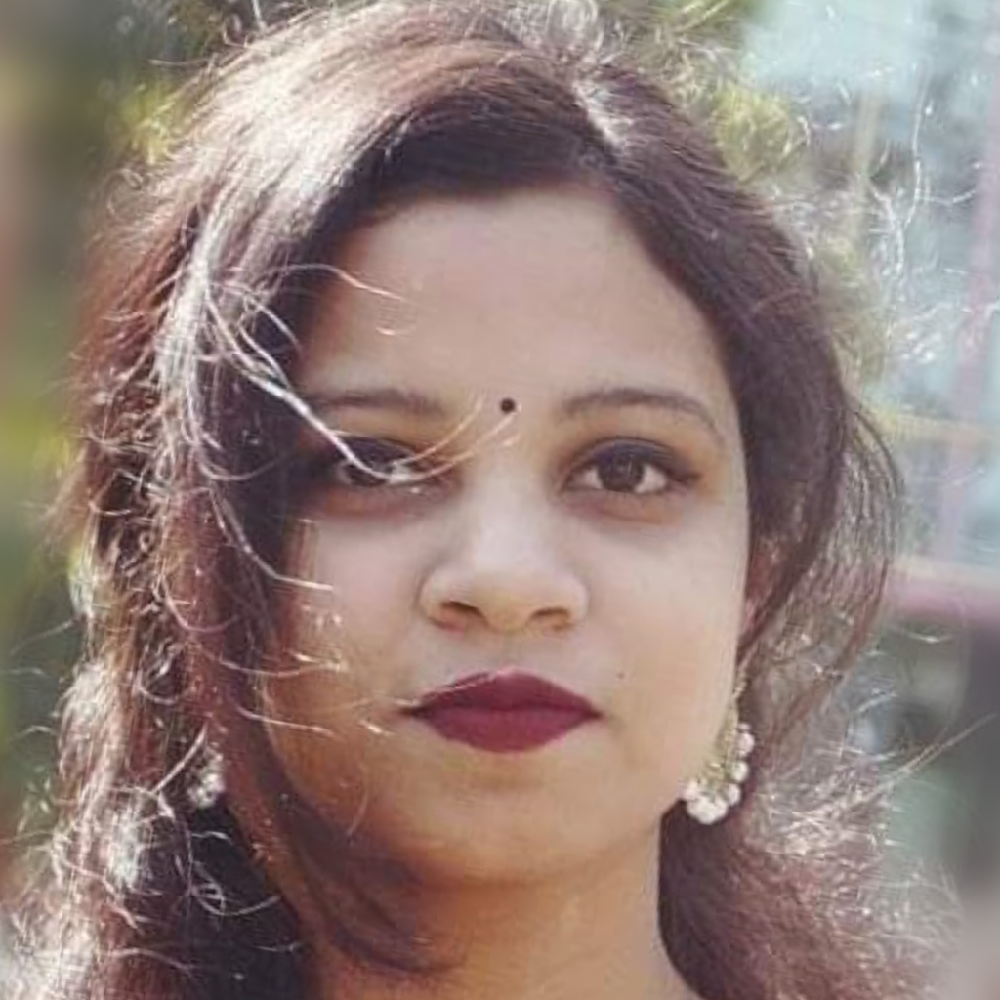

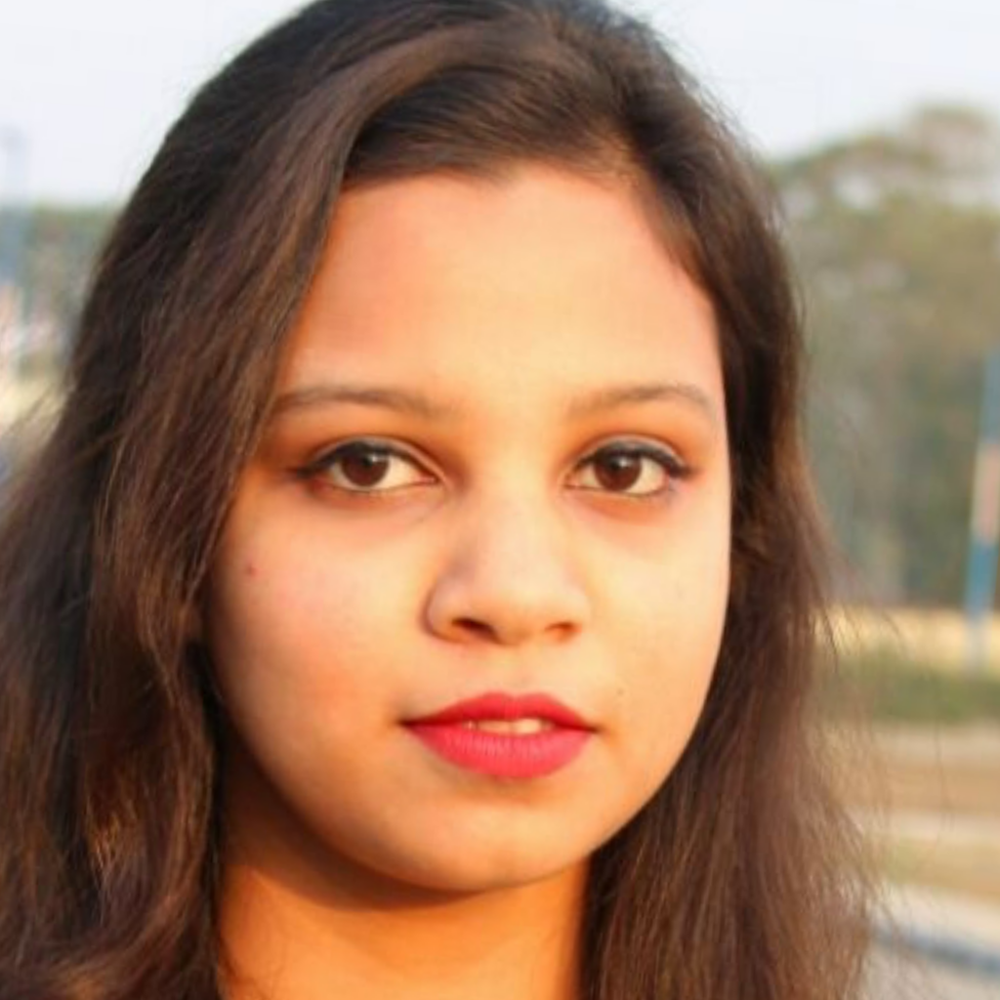

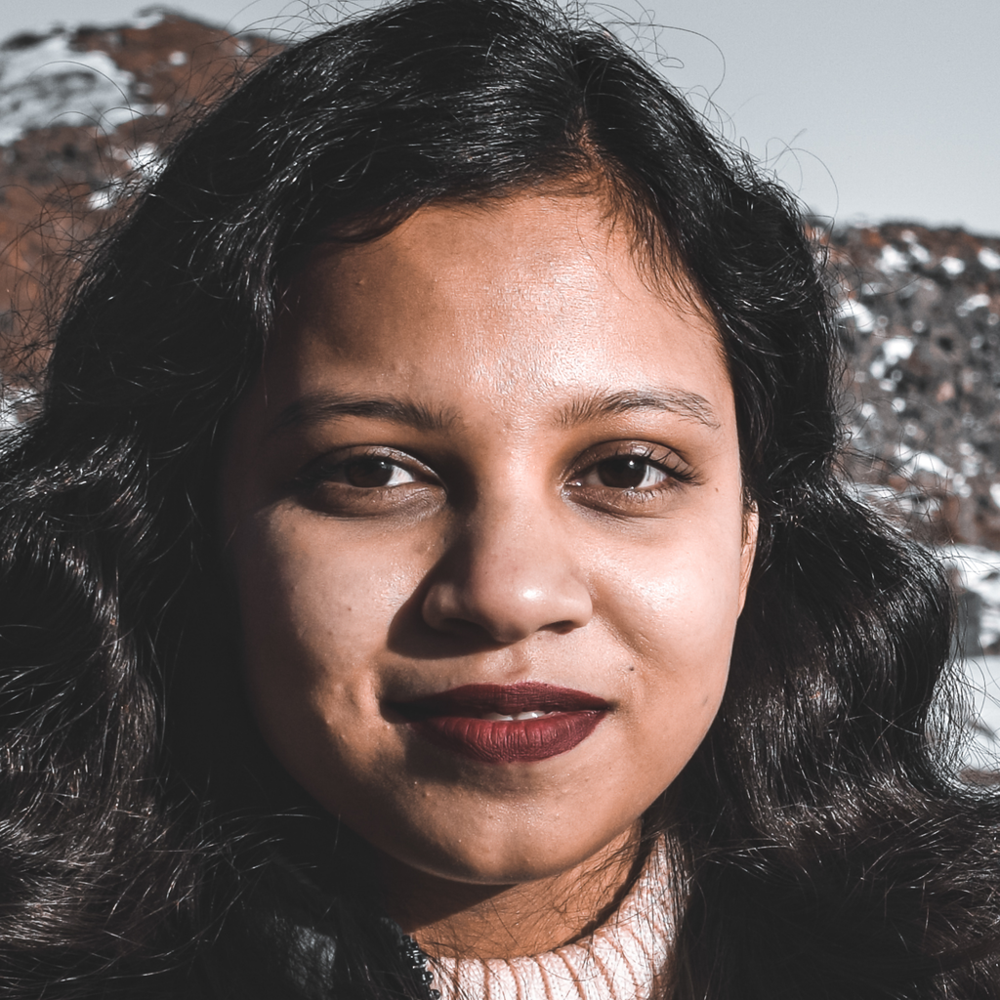

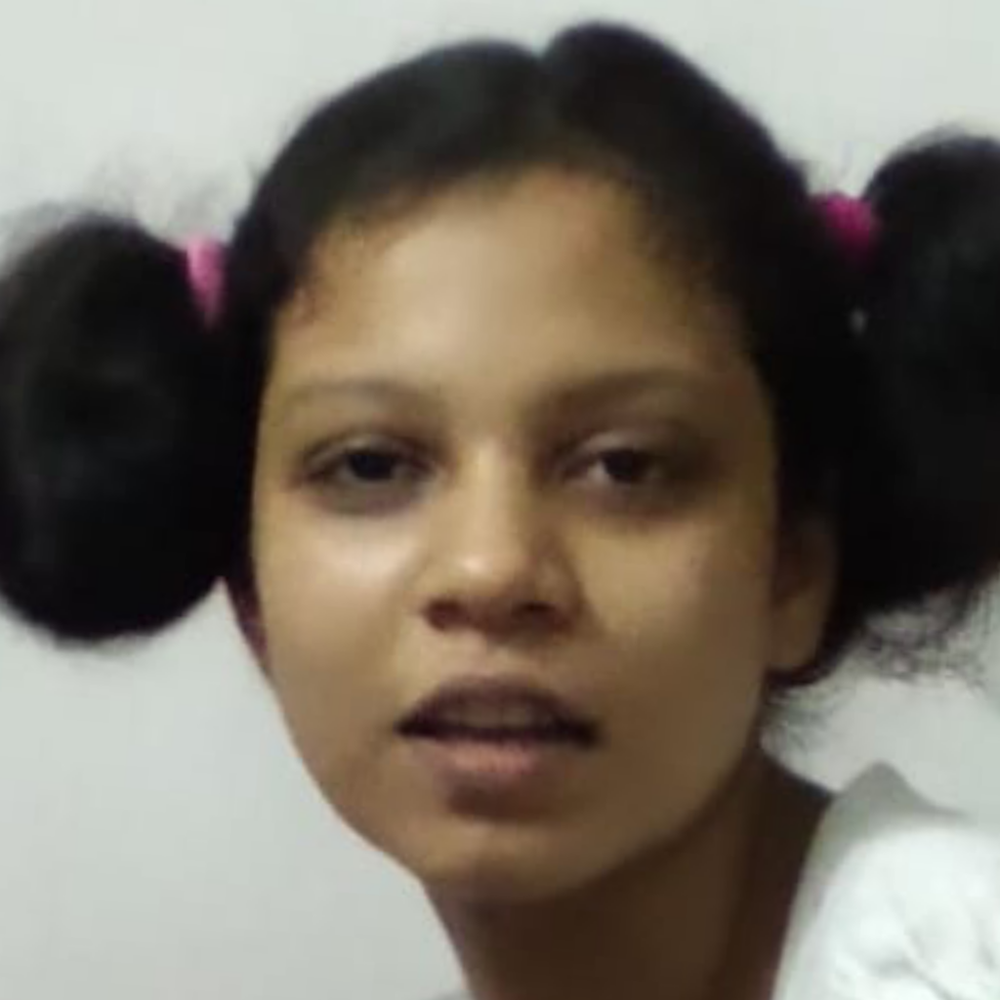

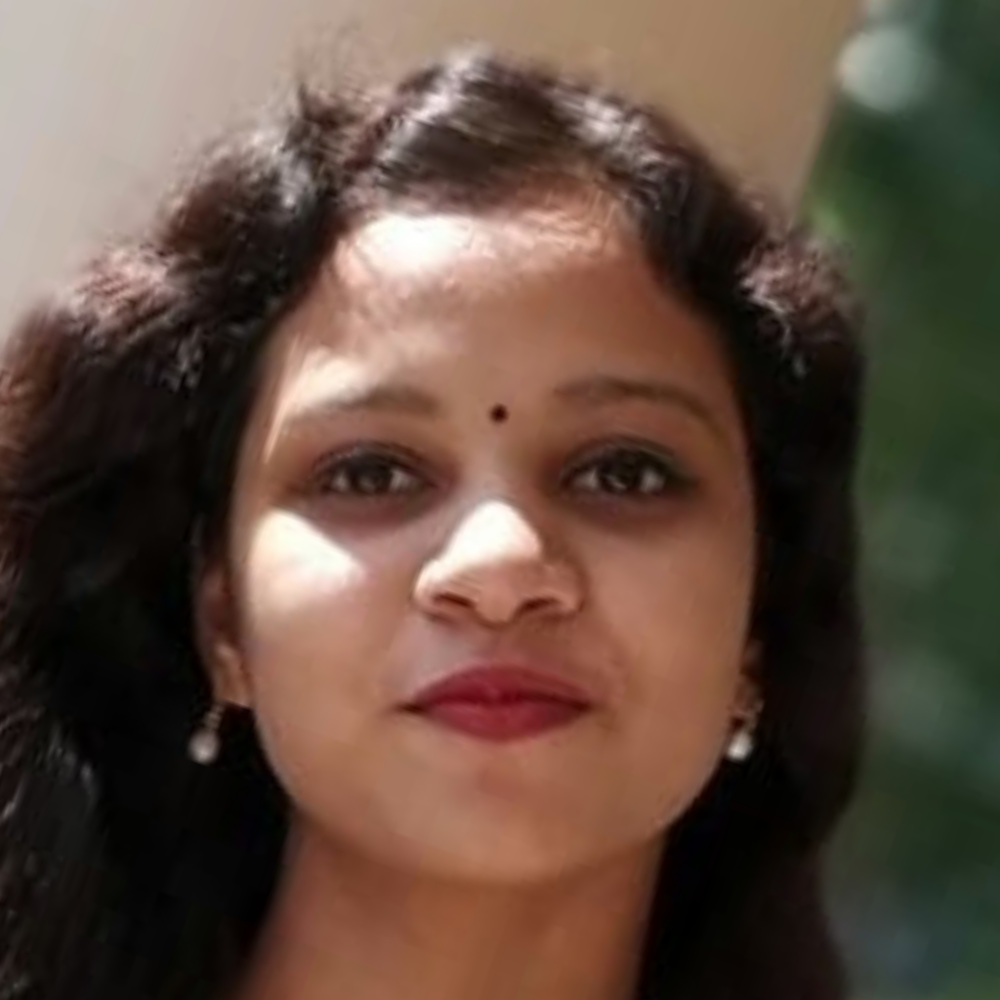

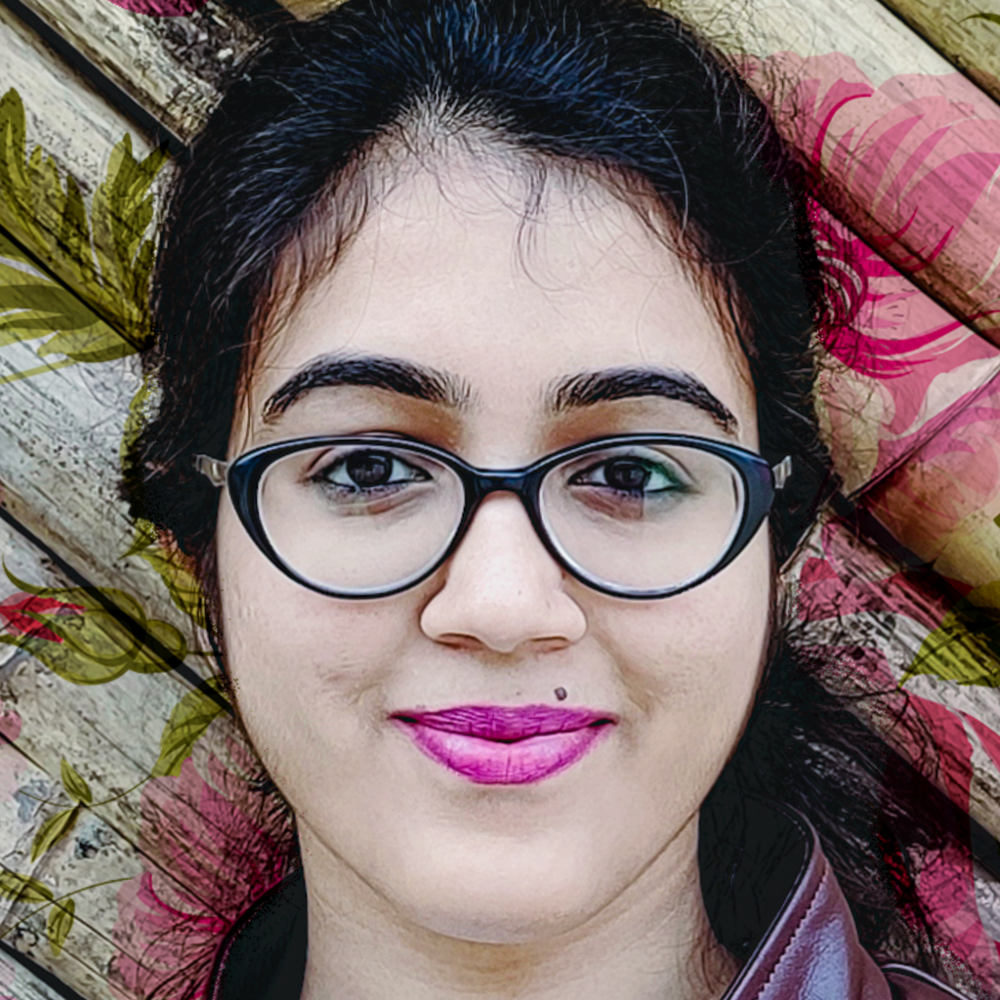

In [50]:
import numpy as np
from PIL import Image
import dnnlib
import dnnlib.tflib as tflib
from pathlib import Path

latent_dir = Path("generated")
latents = latent_dir.glob("*toon.npy")
for latent_file in latents:
  latent = np.load(latent_file)
  latent = np.expand_dims(latent,axis=0)
  synthesis_kwargs = dict(output_transform=dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=False), minibatch_size=8)
  images = Gs_blended.components.synthesis.run(latent, randomize_noise=False, **synthesis_kwargs)
  Image.fromarray(images.transpose((0,2,3,1))[0], 'RGB').save(latent_file.parent / (f"{latent_file.stem}-toon.png"))


['generated/Adrija_01-toon.png', 'generated/sushi_01.png', 'generated/sushi4_01.png', 'generated/sushi2_01-toon.png', 'generated/sushi2_01.png', 'generated/sushi5_01-toon.png', 'generated/sushi4_01-toon.png', 'generated/sushi3_01-toon.png', 'generated/sushi_01-toon.png', 'generated/sushi3_01.png', 'generated/sushi5_01.png', 'generated/Adrija_01.png']


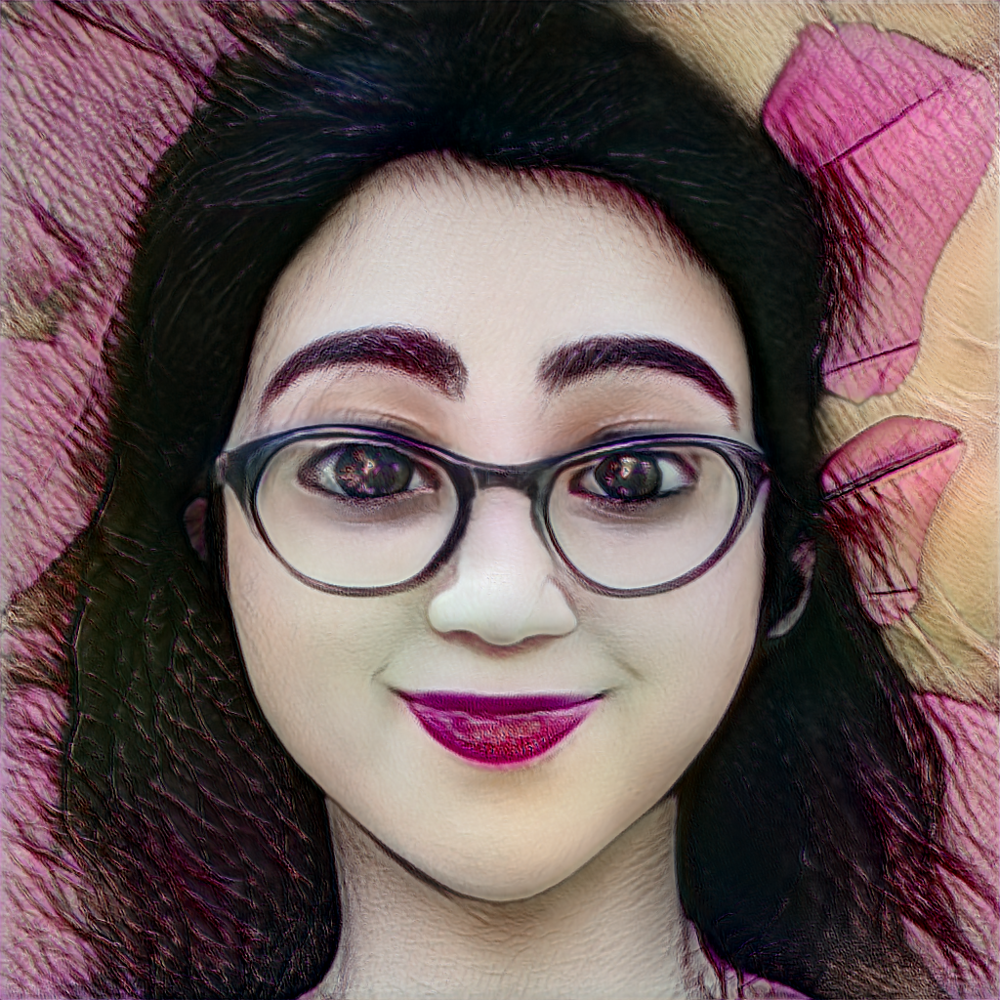

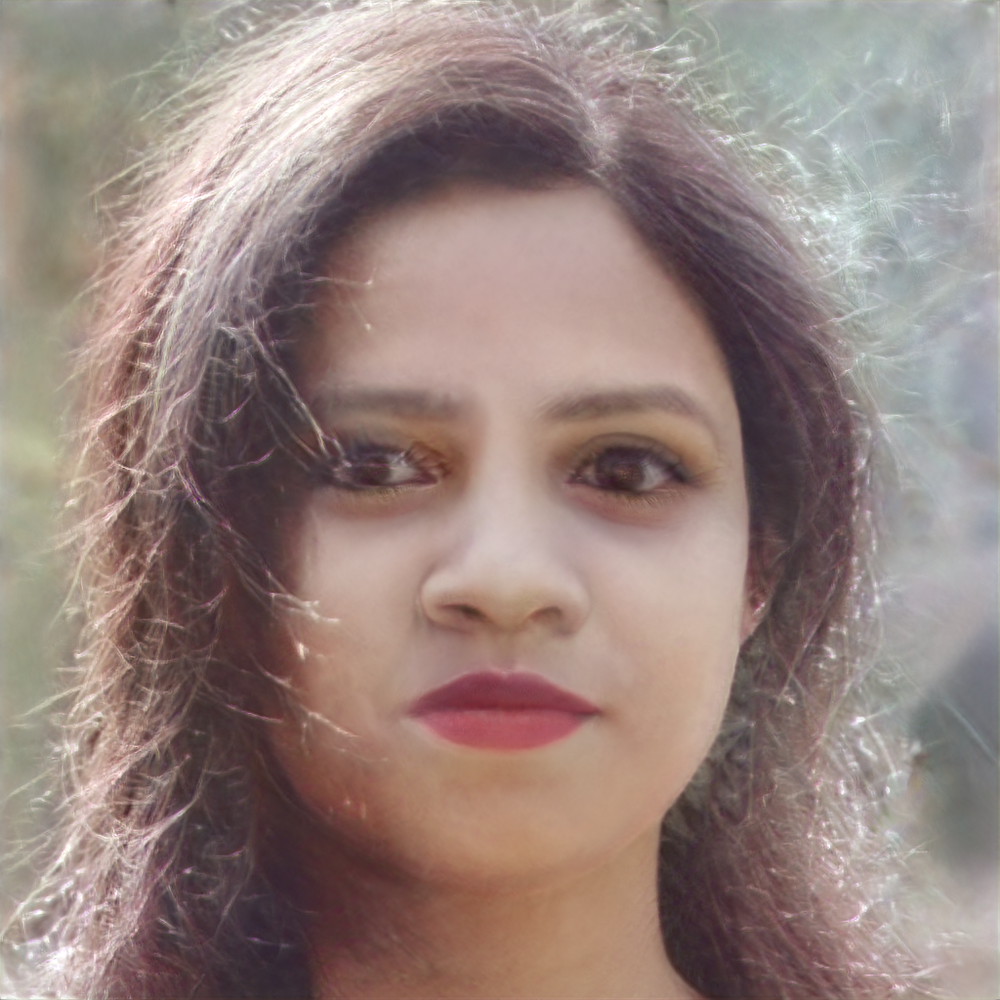

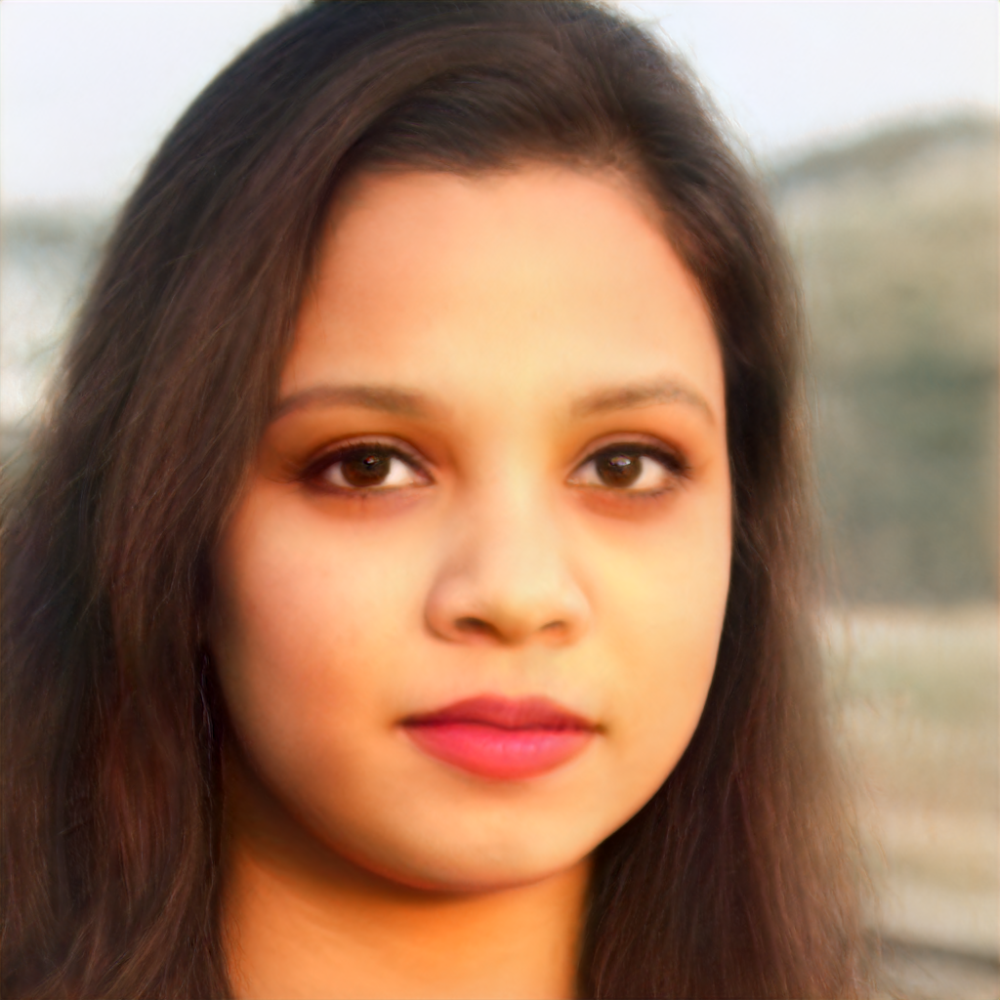

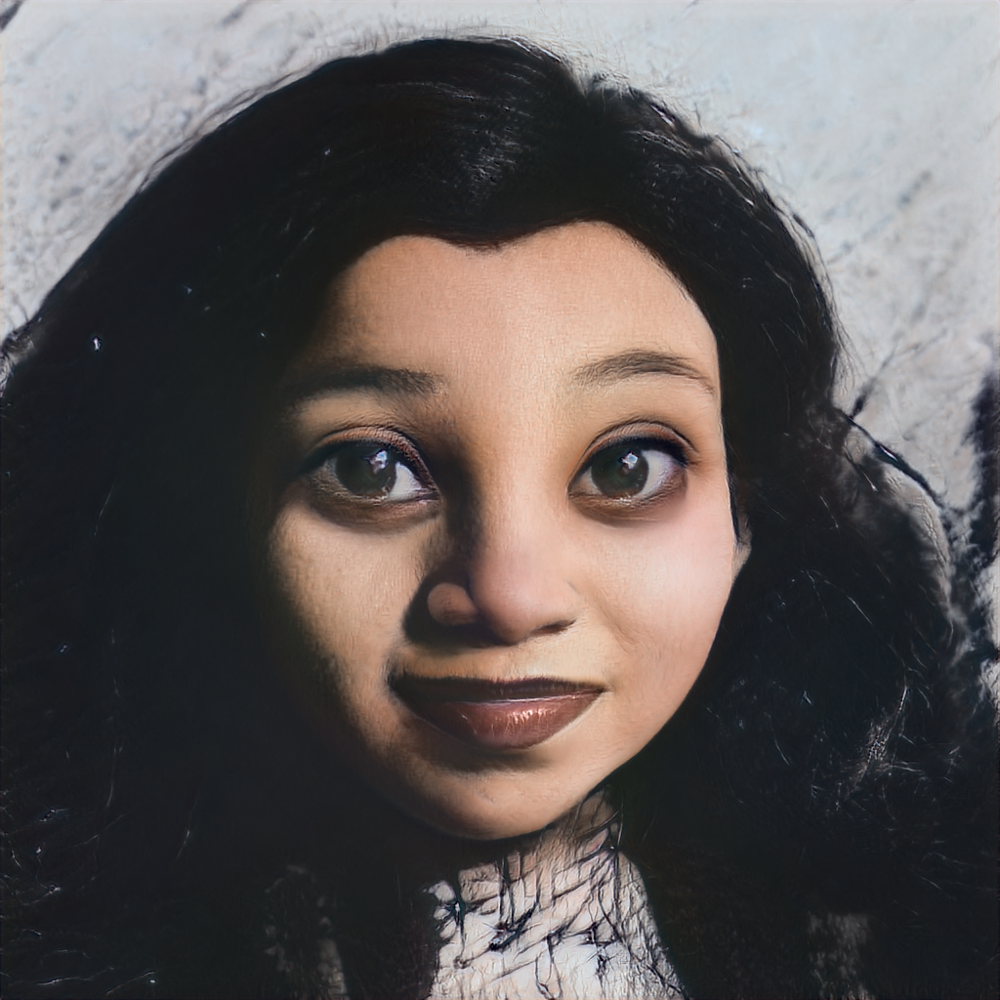

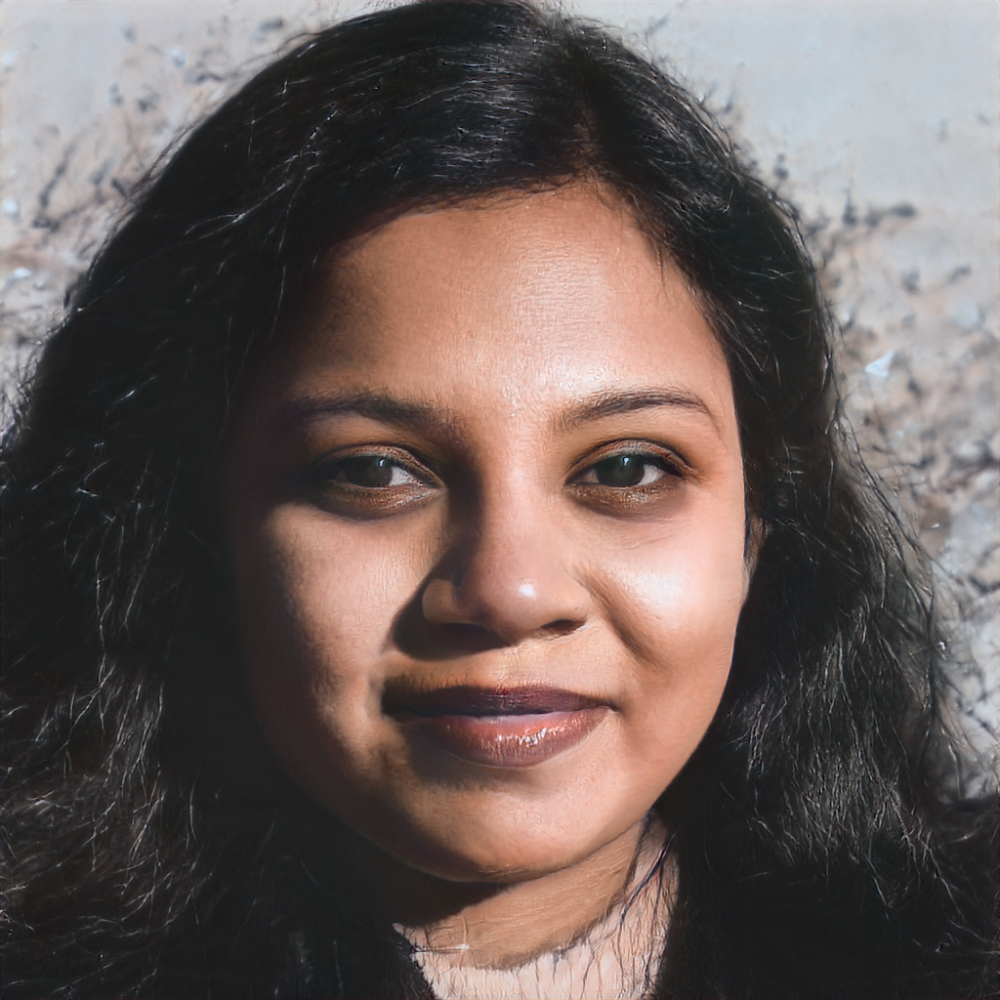

...

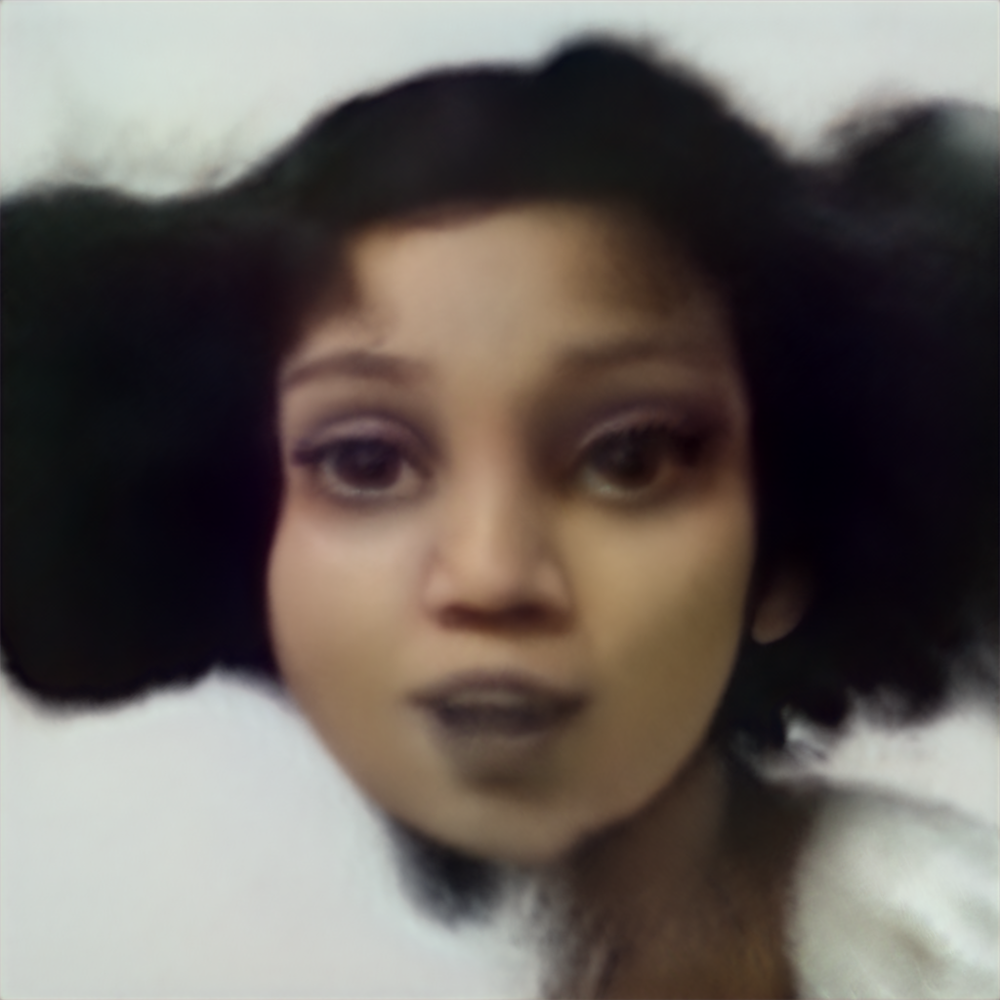

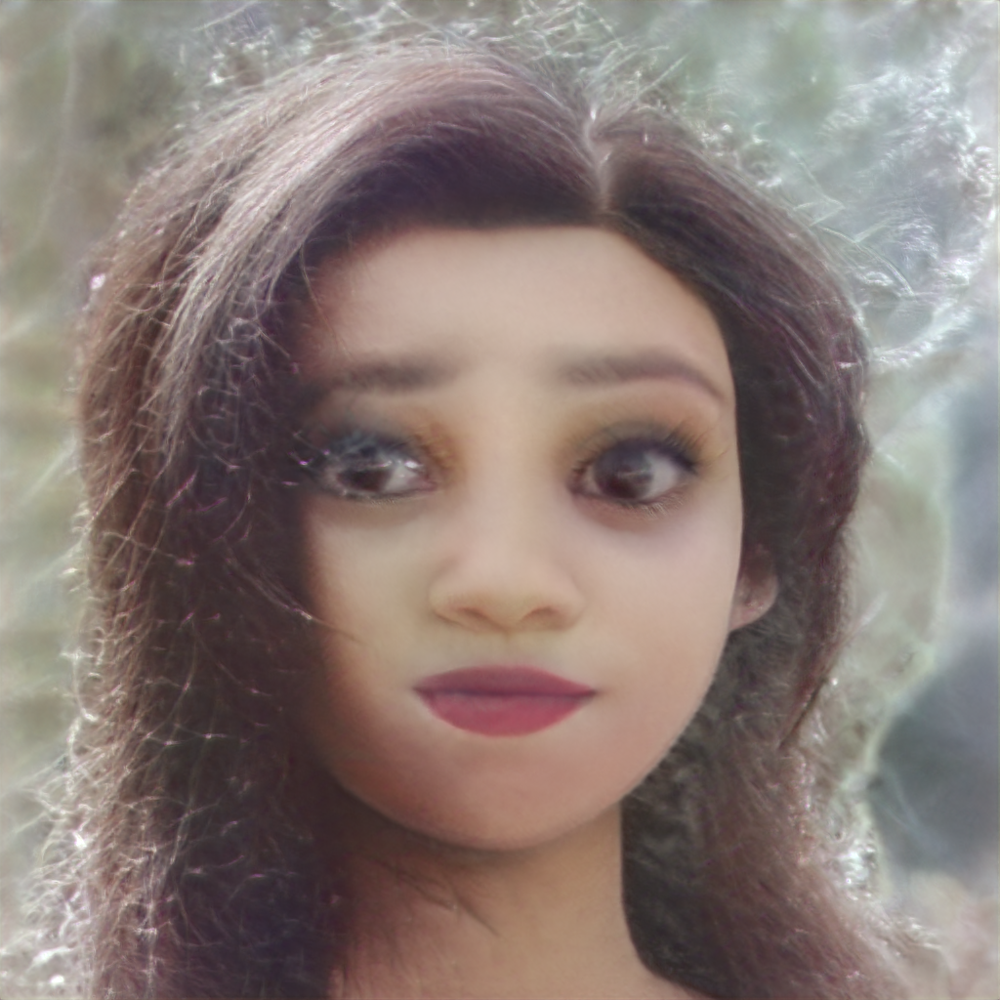

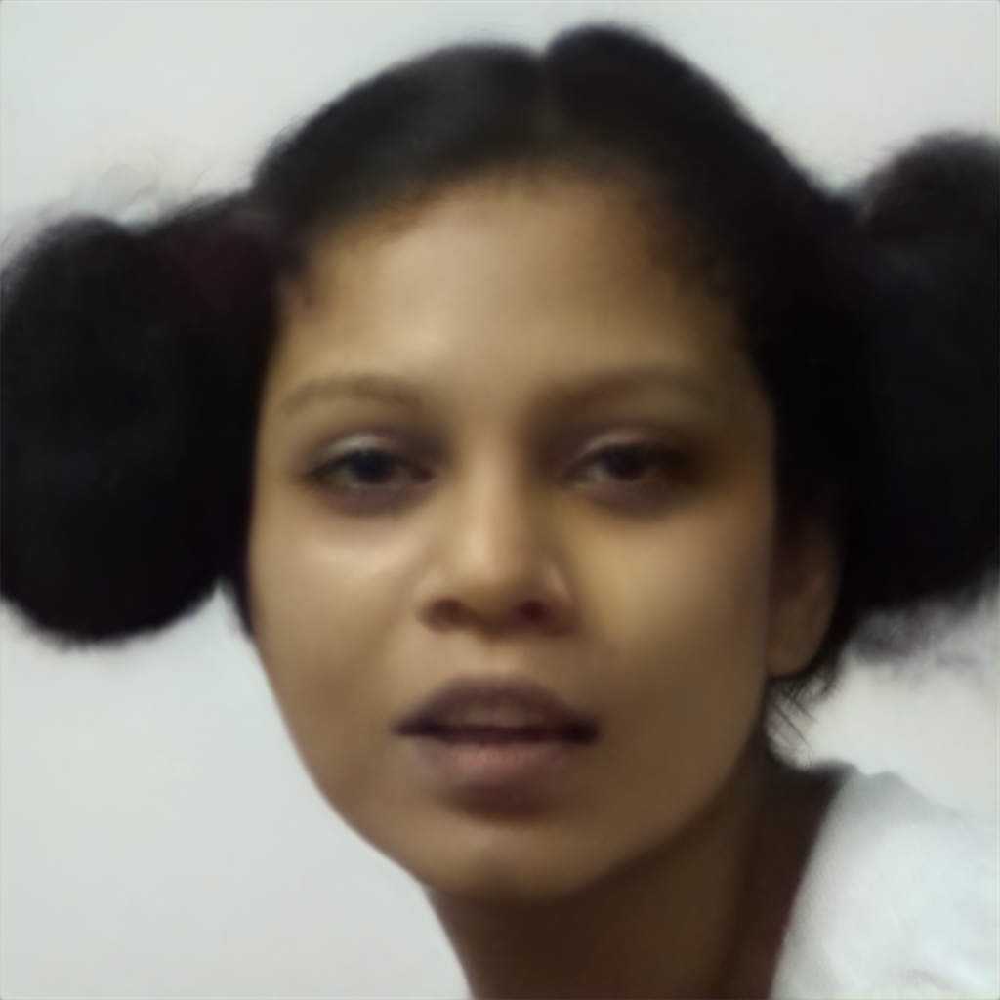

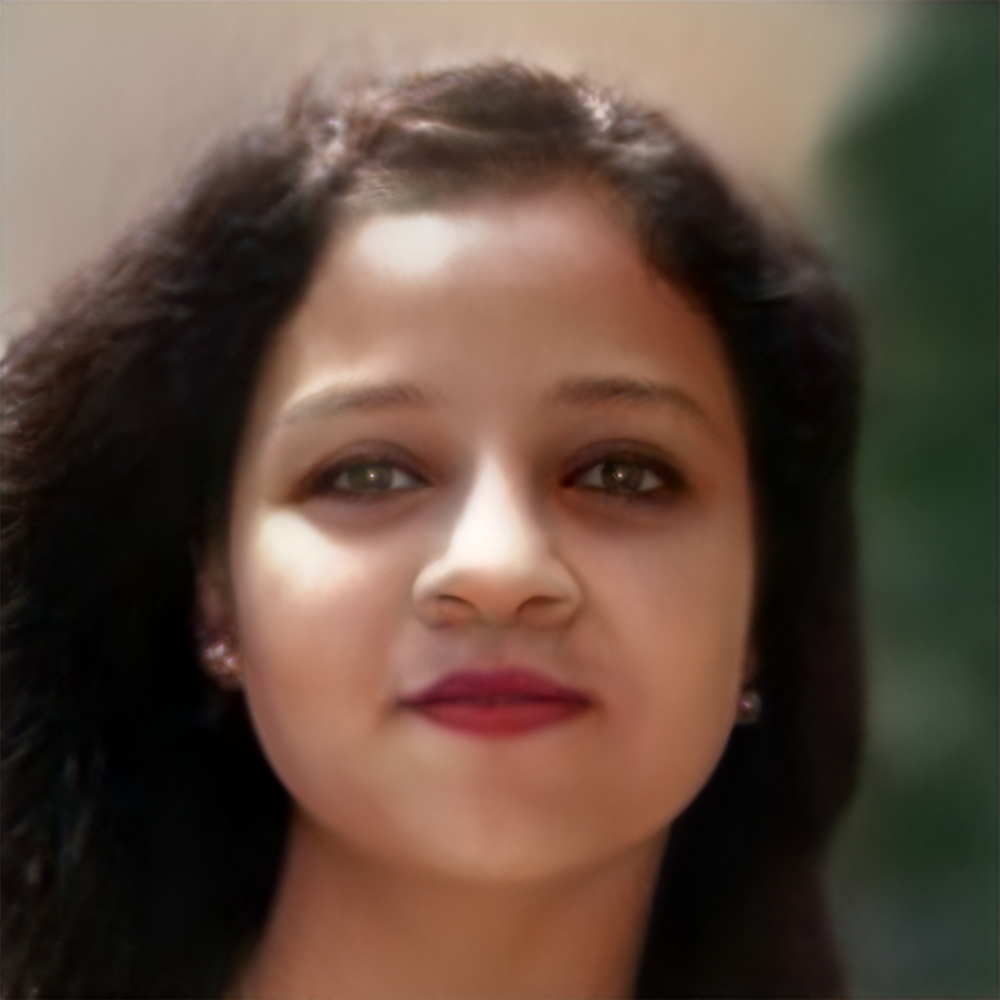

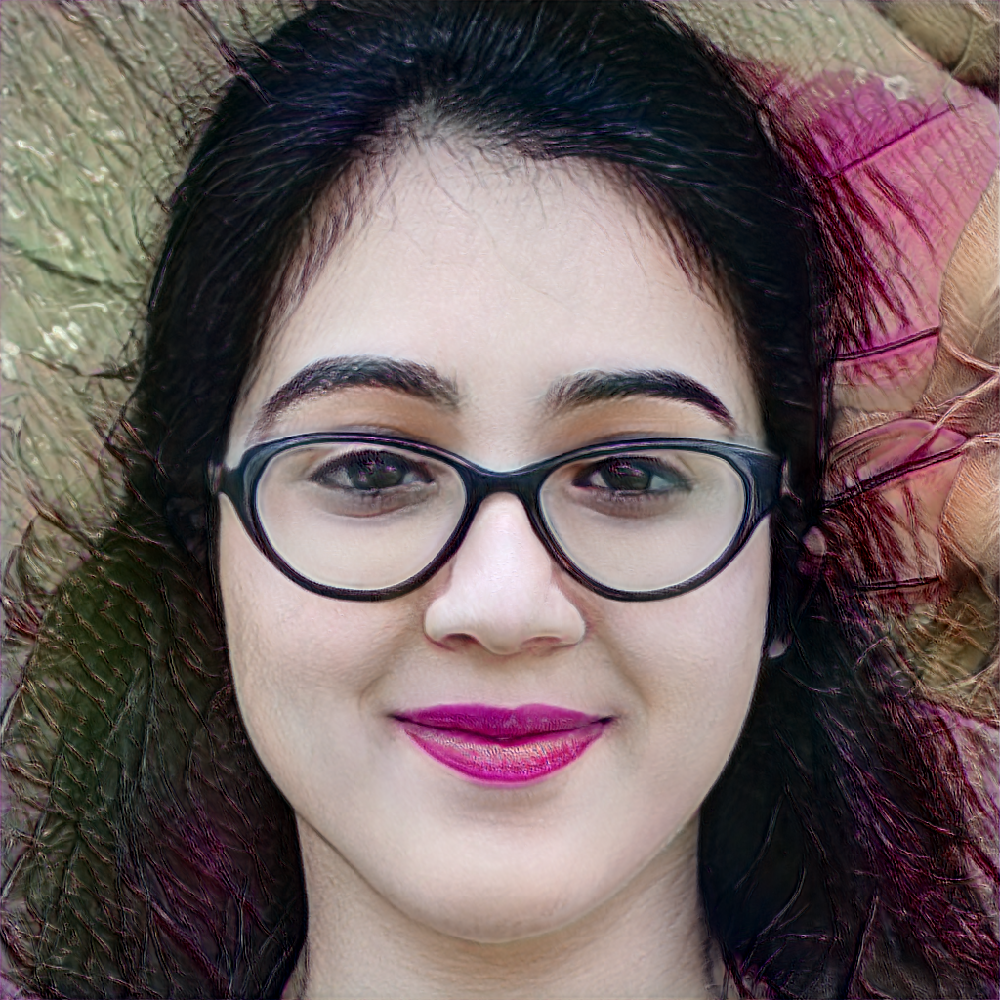

In [51]:
from IPython.display import Image 

import glob

files = glob.glob("generated/*.png")
print(files)

for i in files:
  display(Image(filename=i, width=256))


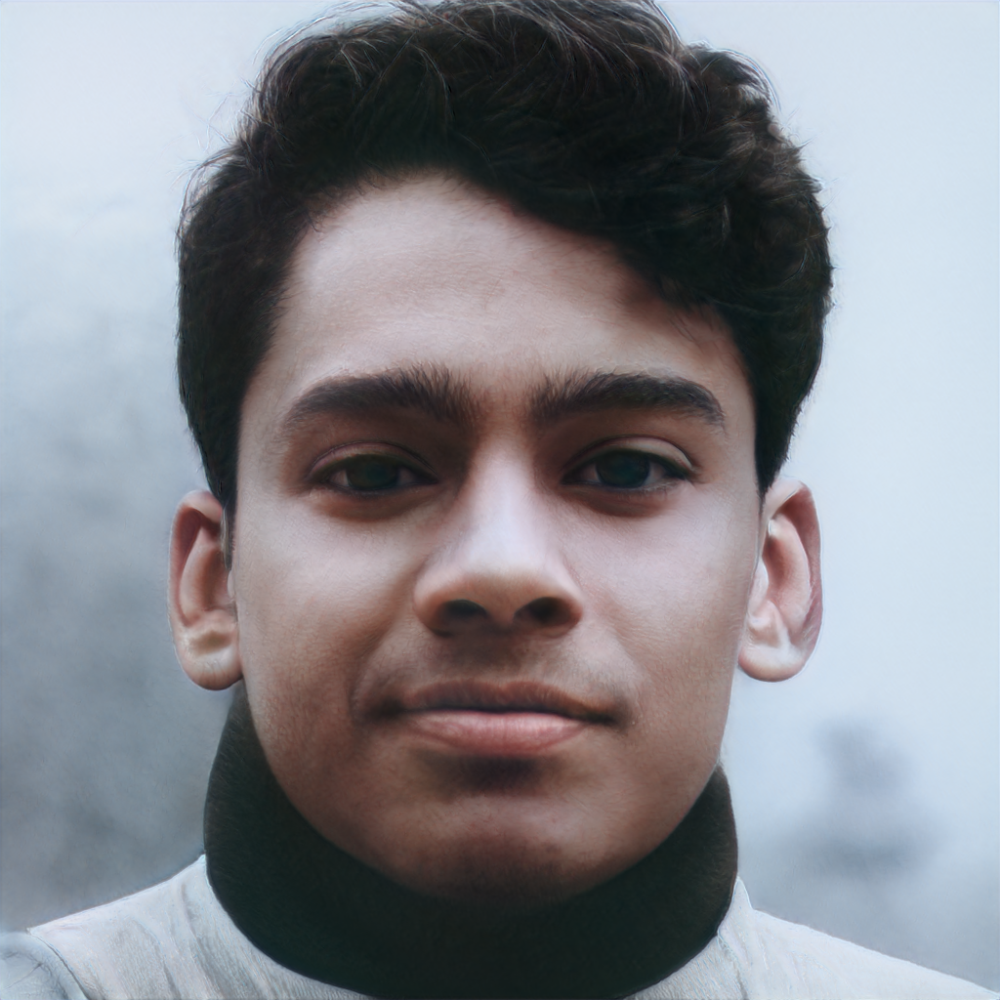

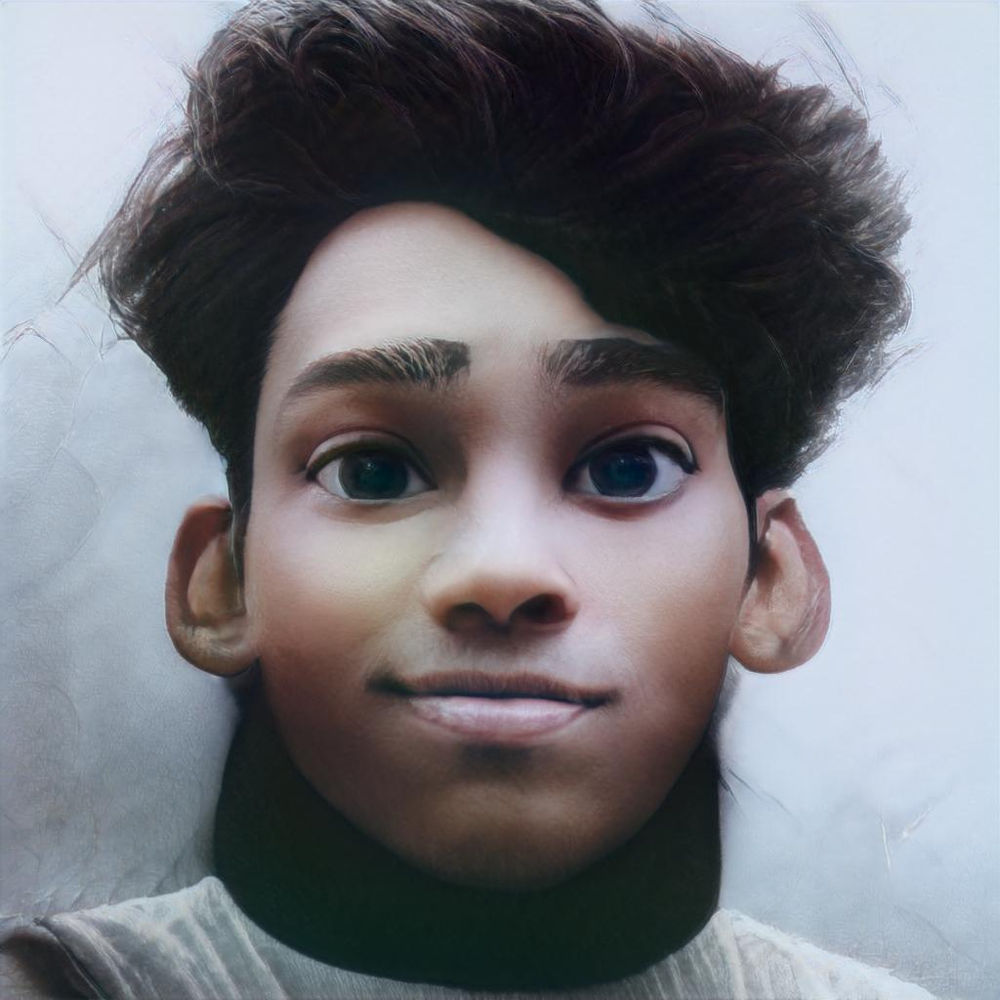

In [40]:
from IPython.display import Image 
tooned = Image(filename="generated/S1_01.png", width=256)
display(tooned)
tooned = Image(filename="generated/S1_01-toon.jpg", width=256)
display(tooned)

